In [0]:
from csv import reader
from pyspark.sql import Row 
from pyspark.sql import SparkSession
from pyspark.sql.types import *
from pyspark.sql.functions import *
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
 
import os
os.environ["PYSPARK_PYTHON"] = "python3"

In [0]:
import urllib.request
urllib.request.urlretrieve("https://data.sfgov.org/api/views/tmnf-yvry/rows.csv?accessType=DOWNLOAD", "/tmp/sf_04_21.csv")
dbutils.fs.mv("file:/tmp/sf_04_21.csv", "dbfs:/lingyiwu4/spark_hw1/data/sf_04_21.csv")
display(dbutils.fs.ls("dbfs:/lingyiwu4/spark_hw1/data/"))

path,name,size,modificationTime
dbfs:/lingyiwu4/spark_hw1/data/covid19.csv,covid19.csv,165748,1713761404000
dbfs:/lingyiwu4/spark_hw1/data/sf_04_21.csv,sf_04_21.csv,550945238,1713761848000


In [0]:
data_path = "dbfs:/lingyiwu4/spark_hw1/data/sf_04_21.csv"

In [0]:
from pyspark.sql import SparkSession
spark = SparkSession \
    .builder \
    .appName("crime analysis") \
    .config("spark.some.config.option", "some-value") \
    .getOrCreate()

df_opt1 = spark.read.format("csv").option("header", "true").load(data_path)
display(df_opt1)
df_opt1.createOrReplaceTempView("sf_crime")

PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,location,SF Find Neighborhoods 2 2,Current Police Districts 2 2,Current Supervisor Districts 2 2,Analysis Neighborhoods 2 2,DELETE - Fire Prevention Districts 2 2,DELETE - Police Districts 2 2,DELETE - Supervisor Districts 2 2,DELETE - Zip Codes 2 2,DELETE - Neighborhoods 2 2,DELETE - 2017 Fix It Zones 2 2,Civic Center Harm Reduction Project Boundary 2 2,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2
4133422003074,041334220,03074,ROBBERY,"ROBBERY, BODILY FORCE",Monday,11/22/2004,17:50,INGLESIDE,NONE,GENEVA AV / SANTOS ST,-122.420084075249,37.7083109744362,POINT (-122.420084075249 37.7083109744362),null,null,9,null,null,null,8,309,null,null,null,null,null,null,null,null,null,null,null,null,null
5118535807021,051185358,07021,VEHICLE THEFT,STOLEN AUTOMOBILE,Tuesday,10/18/2005,20:00,PARK,NONE,TURK ST / STJOSEPHS AV,-120.5,90,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
4018830907021,040188309,07021,VEHICLE THEFT,STOLEN AUTOMOBILE,Sunday,02/15/2004,02:00,SOUTHERN,NONE,BRANNAN ST / 1ST ST,-120.5,90,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
11014543126030,110145431,26030,ARSON,ARSON,Friday,02/18/2011,05:27,INGLESIDE,NONE,0 Block of SANJUAN AV,-122.43622001281,37.7243766140428,POINT (-122.43622001281001 37.7243766140428),94,9,1,28,9,7,6,28861,25,null,null,null,null,null,null,1,null,null,null,null,94
10108108004134,101081080,04134,ASSAULT,BATTERY,Sunday,11/21/2010,17:00,SOUTHERN,NONE,400 Block of 10TH ST,-122.410541166987,37.7709130566165,POINT (-122.410541166987 37.7709130566165),32,1,10,34,8,2,9,28853,34,null,null,null,null,null,null,2,null,null,null,null,32
13027069804134,130270698,04134,ASSAULT,BATTERY,Tuesday,04/02/2013,15:50,TARAVAL,NONE,14TH AV / SANTIAGO ST,-122.470365997562,37.74515794927,POINT (-122.470365997562 37.74515794927),44,10,8,41,1,8,4,29491,40,null,null,null,null,null,null,1,null,null,null,null,44
17063991304134,170639913,04134,ASSAULT,BATTERY,Sunday,08/06/2017,18:15,SOUTHERN,NONE,800 Block of BRYANT ST,-122.40340479147905,37.775420706711,POINT (-122.40340479147905 37.775420706711),32,1,10,34,14,2,9,28853,34,null,null,null,null,null,null,2,null,null,null,null,32
16020415607020,160204156,07020,VEHICLE THEFT,STOLEN AND RECOVERED VEHICLE,Thursday,03/03/2016,19:30,TARAVAL,NONE,100 Block of BEPLER ST,-122.46354501681947,37.70796836450968,POINT (-122.46354501681947 37.70796836450968),null,null,null,null,null,null,null,28588,null,null,null,null,null,null,null,null,null,null,null,null,null
6068579904134,060685799,04134,ASSAULT,BATTERY,Saturday,06/17/2006,03:00,TARAVAL,NONE,3200 Block of SAN JOSE AV,-122.459172646607,37.7082001648459,POINT (-122.459172646607 37.7082001648459),null,null,null,null,null,null,null,28588,null,null,null,null,null,null,null,null,null,null,null,null,null
5134166327195,051341663,27195,TRESPASS,TRESPASSING,Monday,11/28/2005,16:04,TENDERLOIN,"ARREST, BOOKED",ELLIS ST / 5THSTNORTH ST,-120.5,90,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null


In [0]:
df_opt1 = df_opt1.withColumn('Hour', hour(df_opt1['Time']))
# convert string to date type using unix_timestamp
df_opt1 = df_opt1.withColumn("Date",  to_date( from_unixtime(unix_timestamp(df_opt1['Date'], 'MM/dd/yyy'))))
df_opt1 = df_opt1.withColumn("Year",  year(df_opt1.Date))
df_opt1 = df_opt1.withColumn("Month",  month(df_opt1.Date))
df_opt1 = df_opt1.withColumn("Day",  dayofmonth(df_opt1.Date))
df_opt1 = df_opt1.withColumn('HasCriminal', (df_opt1["category"]!="NON-CRIMINAL"))
df_opt1 = df_opt1.withColumn("X",  df_opt1["X"].cast("double"))
df_opt1 = df_opt1.withColumn("Y",  df_opt1["Y"].cast("double"))
df_opt1.createOrReplaceTempView('sf_crime')
display(df_opt1)

PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,location,SF Find Neighborhoods 2 2,Current Police Districts 2 2,Current Supervisor Districts 2 2,Analysis Neighborhoods 2 2,DELETE - Fire Prevention Districts 2 2,DELETE - Police Districts 2 2,DELETE - Supervisor Districts 2 2,DELETE - Zip Codes 2 2,DELETE - Neighborhoods 2 2,DELETE - 2017 Fix It Zones 2 2,Civic Center Harm Reduction Project Boundary 2 2,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2,Hour,Year,Month,Day,HasCriminal
4133422003074,041334220,03074,ROBBERY,"ROBBERY, BODILY FORCE",Monday,2004-11-22,17:50,INGLESIDE,NONE,GENEVA AV / SANTOS ST,-122.420084075249,37.7083109744362,POINT (-122.420084075249 37.7083109744362),null,null,9,null,null,null,8,309,null,null,null,null,null,null,null,null,null,null,null,null,null,17,2004,11,22,true
5118535807021,051185358,07021,VEHICLE THEFT,STOLEN AUTOMOBILE,Tuesday,2005-10-18,20:00,PARK,NONE,TURK ST / STJOSEPHS AV,-120.5,90.0,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,20,2005,10,18,true
4018830907021,040188309,07021,VEHICLE THEFT,STOLEN AUTOMOBILE,Sunday,2004-02-15,02:00,SOUTHERN,NONE,BRANNAN ST / 1ST ST,-120.5,90.0,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2,2004,2,15,true
11014543126030,110145431,26030,ARSON,ARSON,Friday,2011-02-18,05:27,INGLESIDE,NONE,0 Block of SANJUAN AV,-122.43622001281,37.7243766140428,POINT (-122.43622001281001 37.7243766140428),94,9,1,28,9,7,6,28861,25,null,null,null,null,null,null,1,null,null,null,null,94,5,2011,2,18,true
10108108004134,101081080,04134,ASSAULT,BATTERY,Sunday,2010-11-21,17:00,SOUTHERN,NONE,400 Block of 10TH ST,-122.410541166987,37.7709130566165,POINT (-122.410541166987 37.7709130566165),32,1,10,34,8,2,9,28853,34,null,null,null,null,null,null,2,null,null,null,null,32,17,2010,11,21,true
13027069804134,130270698,04134,ASSAULT,BATTERY,Tuesday,2013-04-02,15:50,TARAVAL,NONE,14TH AV / SANTIAGO ST,-122.470365997562,37.74515794927,POINT (-122.470365997562 37.74515794927),44,10,8,41,1,8,4,29491,40,null,null,null,null,null,null,1,null,null,null,null,44,15,2013,4,2,true
17063991304134,170639913,04134,ASSAULT,BATTERY,Sunday,2017-08-06,18:15,SOUTHERN,NONE,800 Block of BRYANT ST,-122.40340479147905,37.775420706711,POINT (-122.40340479147905 37.775420706711),32,1,10,34,14,2,9,28853,34,null,null,null,null,null,null,2,null,null,null,null,32,18,2017,8,6,true
16020415607020,160204156,07020,VEHICLE THEFT,STOLEN AND RECOVERED VEHICLE,Thursday,2016-03-03,19:30,TARAVAL,NONE,100 Block of BEPLER ST,-122.46354501681947,37.70796836450968,POINT (-122.46354501681947 37.70796836450968),null,null,null,null,null,null,null,28588,null,null,null,null,null,null,null,null,null,null,null,null,null,19,2016,3,3,true
6068579904134,060685799,04134,ASSAULT,BATTERY,Saturday,2006-06-17,03:00,TARAVAL,NONE,3200 Block of SAN JOSE AV,-122.459172646607,37.7082001648459,POINT (-122.459172646607 37.7082001648459),null,null,null,null,null,null,null,28588,null,null,null,null,null,null,null,null,null,null,null,null,null,3,2006,6,17,true
5134166327195,051341663,27195,TRESPASS,TRESPASSING,Monday,2005-11-28,16:04,TENDERLOIN,"ARREST, BOOKED",ELLIS ST / 5THSTNORTH ST,-120.5,90.0,POINT (-120.50000000000001 90),null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,16,2005,11,28,true


In [0]:
#Q1 counts the number of crimes for different category

In [0]:
q1_result = df_opt1.groupBy('category').count().orderBy('count', ascending=False)
display(q1_result)

category,count
LARCENY/THEFT,477975
OTHER OFFENSES,301874
NON-CRIMINAL,236928
ASSAULT,167042
VEHICLE THEFT,126228
DRUG/NARCOTIC,117821
VANDALISM,114718
WARRANTS,99821
BURGLARY,91067
SUSPICIOUS OCC,79087


In [0]:
crimeCategory = spark.sql("SELECT  category, COUNT(*) AS crime_counts FROM sf_crime GROUP BY category ORDER BY crime_counts DESC")
crimes_pd_df = crimeCategory.toPandas()
display(crimeCategory)

category,crime_counts
LARCENY/THEFT,477975
OTHER OFFENSES,301874
NON-CRIMINAL,236928
ASSAULT,167042
VEHICLE THEFT,126228
DRUG/NARCOTIC,117821
VANDALISM,114718
WARRANTS,99821
BURGLARY,91067
SUSPICIOUS OCC,79087


In [0]:
#Q2

In [0]:
crime_district_df = spark.sql("select distinct PdDistrict, count(PdDistrict) as crime_counts from \
          ( select  PdDistrict, Category \
            from sf_crime \
            where (Category != 'NON-CRIMINAL') \
            )\
            group by PdDistrict \
            order by crime_counts desc ;")
display(crime_district_df)

PdDistrict,crime_counts
SOUTHERN,340988
MISSION,257385
NORTHERN,240054
CENTRAL,193348
BAYVIEW,189619
TENDERLOIN,168208
INGLESIDE,163661
TARAVAL,137183
PARK,104290
RICHMOND,97860


In [0]:
crime_counts = df_opt1.where(df_opt1['category']!= 'NON-CRIMINAL').groupby(['PdDistrict']).count().orderBy('count', ascending= False)
crime_counts = crime_counts.select(['PdDistrict','count']).withColumnRenamed('count','crime_counts')
display(crime_counts)

PdDistrict,crime_counts
SOUTHERN,340988
MISSION,257385
NORTHERN,240054
CENTRAL,193348
BAYVIEW,189619
TENDERLOIN,168208
INGLESIDE,163661
TARAVAL,137183
PARK,104290
RICHMOND,97860


In [0]:
#Q3

In [0]:
crime_downtown_df =  spark.sql("select Date, DayOfWeek, count(category) as crime_counts from (\
                               select  DayOfWeek, Date, Year, Month, Day, category from sf_crime \
          where (X <-122.4213) and (X >-122.4313) and (Y>37.7540) and (Y< 37.7740) and (DayOfWeek = 'Sunday') and (Category != 'NON-CRIMINAL') )\
          group by DayOfWeek, Date, Year, Month, Day \
          order by Date asc\
          ;")
 
display(crime_downtown_df)

Date,DayOfWeek,crime_counts
2003-01-05,Sunday,13
2003-01-12,Sunday,17
2003-01-19,Sunday,15
2003-01-26,Sunday,12
2003-02-02,Sunday,13
2003-02-09,Sunday,20
2003-02-16,Sunday,11
2003-02-23,Sunday,13
2003-03-02,Sunday,14
2003-03-09,Sunday,7


In [0]:
sf_downtown_df = df_opt1.where("X < -122.4213 and X > -122.4313 and Y< 37.7740 and Y>37.7540 ")
sf_downtown_df = sf_downtown_df.where("DayOfWeek = 'Sunday' and hasCriminal=true").groupby(['Date','DayofWeek']).count().orderBy('Date',ascending=True)
sf_downtown_df = sf_downtown_df.withColumnRenamed("count", "crime_count")
display(sf_downtown_df)

Date,DayofWeek,crime_count
2003-01-05,Sunday,13
2003-01-12,Sunday,17
2003-01-19,Sunday,15
2003-01-26,Sunday,12
2003-02-02,Sunday,13
2003-02-09,Sunday,20
2003-02-16,Sunday,11
2003-02-23,Sunday,13
2003-03-02,Sunday,14
2003-03-09,Sunday,7


In [0]:
#Q4  the number of crime in each month of 2015, 2016, 2017, 2018

In [0]:
years =[2015, 2016, 2017, 2018]
crime_years_df = df_opt1.where(df_opt1.Year.isin(years)).select(["Year", "Month","category","HasCriminal"])
display(crime_years_df)

Year,Month,category,HasCriminal
2017,8,ASSAULT,true
2016,3,VEHICLE THEFT,true
2015,9,FORGERY/COUNTERFEITING,true
2017,10,LARCENY/THEFT,true
2015,9,OTHER OFFENSES,true
2015,9,DRUG/NARCOTIC,true
2015,9,DRUG/NARCOTIC,true
2015,9,OTHER OFFENSES,true
2015,9,VANDALISM,true
2015,3,NON-CRIMINAL,false


In [0]:
hasCrime_count = crime_years_df.where("HasCriminal=true").groupby(["Year","Month"]).count().orderBy(["Year", "Month"],ascending=True)
hasCrime_count = hasCrime_count.withColumnRenamed('count', 'crime_count')
hasCrime_count_pd = hasCrime_count.toPandas()
 
NonCrime_count = crime_years_df.where("HasCriminal=false").groupby(["Year","Month"]).count().orderBy(["Year", "Month"],ascending=True)
NonCrime_count = NonCrime_count.withColumnRenamed('count', 'Non-criminal_count')
NonCrime_count_pd = NonCrime_count.toPandas()
display(hasCrime_count)
 

Year,Month,crime_count
2015,1,11509
2015,2,10332
2015,3,11735
2015,4,10903
2015,5,11693
2015,6,11275
2015,7,11361
2015,8,11598
2015,9,10887
2015,10,11120


In [0]:
display(df_opt1.where("Year =2018").groupby(["Month"]).count().orderBy(["Month"]))

Month,count
1,11667
2,9565
3,10354
4,9954
5,3519


In [0]:
display(hasCrime_count)

Year,Month,crime_count
2015,1,11509
2015,2,10332
2015,3,11735
2015,4,10903
2015,5,11693
2015,6,11275
2015,7,11361
2015,8,11598
2015,9,10887
2015,10,11120


In [0]:
#Q5 

In [0]:
date_ls = ["2015-12-15", "2016-12-15","2017-12-15"]
 
sf_downtown_df = df_opt1.where("X < -122.4213 and X > -122.4313 and Y< 37.7740 and Y>37.7540 ").where(sf_downtown_df.Date.isin(date_ls))
sf_crime_count_df = sf_downtown_df.where("hasCriminal = true").groupby(['Date','Hour','DayOfWeek']).count().orderBy([ "Hour"], ascending=True)
sf_crime_count_df = sf_crime_count_df.withColumnRenamed("count", "crime_count")
sf_crime_count_df = sf_crime_count_df.toPandas()
display(sf_crime_count_df)

Date,Hour,DayOfWeek,crime_count
2017-12-15,0,Friday,1
2016-12-15,2,Thursday,3
2017-12-15,2,Friday,3
2015-12-15,4,Tuesday,3
2016-12-15,7,Thursday,1
2017-12-15,8,Friday,1
2016-12-15,8,Thursday,3
2016-12-15,9,Thursday,1
2016-12-15,12,Thursday,1
2017-12-15,12,Friday,1


In [0]:
# Q6
# (1) Step1: Find out the top-3 danger disrict
# (2) Step2: find out the crime event w.r.t category and time (hour) from the result of step 1
# (3) give your advice to distribute the police based on your analysis results.

In [0]:
danger_district_pd = df_opt1.where("hasCriminal =true").groupby([ "PdDistrict"]).count().orderBy(["count"],ascending=False).limit(3).toPandas()["PdDistrict"].tolist()[-1]
# find the crime event
crime_events= df_opt1.where("hasCriminal=true").where(df_opt1.PdDistrict == danger_district_pd).select(["PdDistrict","category","Hour"])
crime_events = crime_events.groupby(["PdDistrict","category","Hour"]).count().orderBy(["Hour"], ascending=True)
crime_events = crime_events.withColumnRenamed('count',"crime_count")
display(crime_events)

PdDistrict,category,Hour,crime_count
NORTHERN,DRIVING UNDER THE INFLUENCE,0,72
NORTHERN,KIDNAPPING,0,35
NORTHERN,DRUNKENNESS,0,75
NORTHERN,FORGERY/COUNTERFEITING,0,428
NORTHERN,SUSPICIOUS OCC,0,574
NORTHERN,LOITERING,0,17
NORTHERN,STOLEN PROPERTY,0,104
NORTHERN,OTHER OFFENSES,0,2029
NORTHERN,PROSTITUTION,0,370
NORTHERN,LIQUOR LAWS,0,12


In [0]:
display(crime_events)

PdDistrict,category,Hour,crime_count
NORTHERN,DRIVING UNDER THE INFLUENCE,0,72
NORTHERN,KIDNAPPING,0,35
NORTHERN,DRUNKENNESS,0,75
NORTHERN,FORGERY/COUNTERFEITING,0,428
NORTHERN,SUSPICIOUS OCC,0,574
NORTHERN,LOITERING,0,17
NORTHERN,STOLEN PROPERTY,0,104
NORTHERN,OTHER OFFENSES,0,2029
NORTHERN,PROSTITUTION,0,370
NORTHERN,LIQUOR LAWS,0,12


In [0]:
#Q7:For different category of crime, find the percentage of resolution.

In [0]:
percentage_df = df_opt1.where("hasCriminal=true").groupby(["category","Resolution"]).count().orderBy(["count"], descending=True)
percentage_df.createOrReplaceTempView('resolution_count')
percentage_df = spark.sql("with category_count as (select category, sum(count) as total_counts from resolution_count group by category) \
select  a.category, b.Resolution, b.count, a.total_counts, 100*b.count/a.total_counts as percentage from (category_count a \
left join resolution_count b on a.category = b.category \
)")
display(percentage_df)

category,Resolution,count,total_counts,percentage
FRAUD,COMPLAINANT REFUSES TO PROSECUTE,46,41348,0.11125084647383186
FRAUD,LOCATED,7,41348,0.01692947663732224
FRAUD,PROSECUTED BY OUTSIDE AGENCY,881,41348,2.130695559640128
FRAUD,EXCEPTIONAL CLEARANCE,129,41348,0.31198606945922414
FRAUD,NONE,32057,41348,77.52974750894843
FRAUD,"ARREST, BOOKED",4940,41348,11.947373512624553
FRAUD,PSYCHOPATHIC CASE,10,41348,0.02418496662474606
FRAUD,NOT PROSECUTED,1940,41348,4.691883525200735
FRAUD,PROSECUTED FOR LESSER OFFENSE,2,41348,0.004836993324949211
FRAUD,"ARREST, CITED",921,41348,2.227435426139112


In [0]:
resol_df = df_opt1.where("hasCriminal=true").groupby(["category","Resolution"]).count().orderBy(["count"], descending=True).withColumnRenamed('count','resol_count')
category_df = df_opt1.where("hasCriminal=true").groupby(["category"]).count().withColumnRenamed('count','category_count')
perc_df = category_df.join(resol_df, resol_df.category == category_df.category,'left')
perc_df = perc_df.withColumn('percentage', 100.0*perc_df.resol_count/perc_df.category_count)
display(perc_df)

category,category_count,category,Resolution,resol_count,percentage
FRAUD,41348,FRAUD,COMPLAINANT REFUSES TO PROSECUTE,46,0.11125084647383186
FRAUD,41348,FRAUD,LOCATED,7,0.01692947663732224
FRAUD,41348,FRAUD,PROSECUTED BY OUTSIDE AGENCY,881,2.130695559640128
FRAUD,41348,FRAUD,EXCEPTIONAL CLEARANCE,129,0.31198606945922414
FRAUD,41348,FRAUD,NONE,32057,77.52974750894843
FRAUD,41348,FRAUD,"ARREST, BOOKED",4940,11.947373512624553
FRAUD,41348,FRAUD,PSYCHOPATHIC CASE,10,0.02418496662474606
FRAUD,41348,FRAUD,NOT PROSECUTED,1940,4.691883525200735
FRAUD,41348,FRAUD,PROSECUTED FOR LESSER OFFENSE,2,0.004836993324949211
FRAUD,41348,FRAUD,"ARREST, CITED",921,2.227435426139112


In [0]:
perc_df_pd = perc_df.toPandas()
perc_df_pd = perc_df_pd.loc[:,~perc_df_pd.columns.duplicated()]

In [0]:
print("Number of categories: ", len(perc_df_pd .category.unique()))
print("Number of Resolution: ",len(perc_df_pd.Resolution.unique()))
print("\n")
print("Categories:")
print(perc_df_pd .category.unique())
print("Resolution::")
print(perc_df_pd .Resolution.unique())

Number of categories:  36
Number of Resolution:  12


Categories:
['FRAUD' 'SUICIDE' 'LIQUOR LAWS' 'SECONDARY CODES' 'MISSING PERSON'
 'OTHER OFFENSES' 'DRIVING UNDER THE INFLUENCE' 'WARRANTS' 'ARSON'
 'FORGERY/COUNTERFEITING' 'GAMBLING' 'BRIBERY' 'ASSAULT' 'DRUNKENNESS'
 'EXTORTION' 'TREA' 'WEAPON LAWS' 'LOITERING' 'SUSPICIOUS OCC' 'ROBBERY'
 'SEX OFFENSES, FORCIBLE' 'PROSTITUTION' 'EMBEZZLEMENT' 'BAD CHECKS'
 'DISORDERLY CONDUCT' 'RECOVERED VEHICLE' 'VANDALISM' 'DRUG/NARCOTIC'
 'PORNOGRAPHY/OBSCENE MAT' 'TRESPASS' 'VEHICLE THEFT' 'STOLEN PROPERTY'
 'LARCENY/THEFT' 'KIDNAPPING' 'BURGLARY' 'SEX OFFENSES, NON FORCIBLE']
Resolution::
['COMPLAINANT REFUSES TO PROSECUTE' 'LOCATED'
 'PROSECUTED BY OUTSIDE AGENCY' 'EXCEPTIONAL CLEARANCE' 'NONE'
 'ARREST, BOOKED' 'PSYCHOPATHIC CASE' 'NOT PROSECUTED'
 'PROSECUTED FOR LESSER OFFENSE' 'ARREST, CITED'
 'DISTRICT ATTORNEY REFUSES TO PROSECUTE' 'UNFOUNDED']


In [0]:
category_ls = perc_df_pd.category.unique()
num_charts = 4
num_groups = len(category_ls)//num_charts
chart_groups = [category_ls[i*num_charts:(i+1)*num_charts] for i in range(num_groups)]
chart_groups.append(category_ls[num_groups*num_charts :])
 
display(perc_df_pd[perc_df_pd.category.isin(chart_groups[0]) ])

category,category_count,Resolution,resol_count,percentage
FRAUD,41348,COMPLAINANT REFUSES TO PROSECUTE,46,0.11125084647383186
FRAUD,41348,LOCATED,7,0.01692947663732224
FRAUD,41348,PROSECUTED BY OUTSIDE AGENCY,881,2.130695559640128
FRAUD,41348,EXCEPTIONAL CLEARANCE,129,0.31198606945922414
FRAUD,41348,NONE,32057,77.52974750894843
FRAUD,41348,"ARREST, BOOKED",4940,11.947373512624553
FRAUD,41348,PSYCHOPATHIC CASE,10,0.02418496662474606
FRAUD,41348,NOT PROSECUTED,1940,4.691883525200735
FRAUD,41348,PROSECUTED FOR LESSER OFFENSE,2,0.004836993324949211
FRAUD,41348,"ARREST, CITED",921,2.227435426139112


In [0]:
display(perc_df_pd[perc_df_pd.category.isin(chart_groups[1]) ])

category,category_count,Resolution,resol_count,percentage
MISSING PERSON,44268,DISTRICT ATTORNEY REFUSES TO PROSECUTE,15,0.033884521550555706
MISSING PERSON,44268,COMPLAINANT REFUSES TO PROSECUTE,12,0.027107617240444564
MISSING PERSON,44268,"ARREST, CITED",296,0.6686545585976326
MISSING PERSON,44268,NOT PROSECUTED,19,0.042920393964037226
MISSING PERSON,44268,"ARREST, BOOKED",1125,2.541339116291678
MISSING PERSON,44268,UNFOUNDED,827,1.8681666214873045
MISSING PERSON,44268,PSYCHOPATHIC CASE,426,0.962320412035782
MISSING PERSON,44268,LOCATED,19615,44.30965934761001
MISSING PERSON,44268,NONE,21630,48.861480075901326
MISSING PERSON,44268,EXCEPTIONAL CLEARANCE,271,0.6121803560133731


In [0]:
display(perc_df_pd[perc_df_pd.category.isin(chart_groups[2]) ])

category,category_count,Resolution,resol_count,percentage
ARSON,3875,EXCEPTIONAL CLEARANCE,2,0.05161290322580645
ARSON,3875,PROSECUTED FOR LESSER OFFENSE,1,0.025806451612903226
ARSON,3875,NOT PROSECUTED,3,0.07741935483870968
ARSON,3875,UNFOUNDED,25,0.6451612903225806
ARSON,3875,"ARREST, BOOKED",630,16.258064516129032
ARSON,3875,PSYCHOPATHIC CASE,17,0.43870967741935485
ARSON,3875,PROSECUTED BY OUTSIDE AGENCY,3,0.07741935483870968
ARSON,3875,"ARREST, CITED",17,0.43870967741935485
ARSON,3875,COMPLAINANT REFUSES TO PROSECUTE,3,0.07741935483870968
ARSON,3875,NONE,3174,81.90967741935484


In [0]:
display(perc_df_pd[perc_df_pd.category.isin(chart_groups[3]) ])

category,category_count,Resolution,resol_count,percentage
ASSAULT,167042,DISTRICT ATTORNEY REFUSES TO PROSECUTE,2051,1.2278349157696866
ASSAULT,167042,COMPLAINANT REFUSES TO PROSECUTE,1797,1.0757773494091307
ASSAULT,167042,LOCATED,93,0.055674620754061856
ASSAULT,167042,PROSECUTED BY OUTSIDE AGENCY,102,0.061062487278648485
ASSAULT,167042,EXCEPTIONAL CLEARANCE,632,0.3783479603931945
ASSAULT,167042,"ARREST, BOOKED",49246,29.481208318865914
ASSAULT,167042,UNFOUNDED,1000,0.5986518360651812
ASSAULT,167042,PSYCHOPATHIC CASE,403,0.24125668993426802
ASSAULT,167042,PROSECUTED FOR LESSER OFFENSE,12,0.007183822032782175
ASSAULT,167042,"ARREST, CITED",7027,4.206726452030028


In [0]:
display(perc_df_pd[perc_df_pd.category.isin(chart_groups[4])])

category,category_count,Resolution,resol_count,percentage
WEAPON LAWS,21004,"ARREST, CITED",1157,5.508474576271187
WEAPON LAWS,21004,PROSECUTED FOR LESSER OFFENSE,1,0.004760997905160921
WEAPON LAWS,21004,NOT PROSECUTED,66,0.31422586174062084
WEAPON LAWS,21004,UNFOUNDED,156,0.7427156732051038
WEAPON LAWS,21004,PROSECUTED BY OUTSIDE AGENCY,15,0.07141496857741382
WEAPON LAWS,21004,EXCEPTIONAL CLEARANCE,39,0.18567891830127595
WEAPON LAWS,21004,COMPLAINANT REFUSES TO PROSECUTE,45,0.21424490573224148
WEAPON LAWS,21004,NONE,6070,28.899257284326794
WEAPON LAWS,21004,PSYCHOPATHIC CASE,20,0.09521995810321844
WEAPON LAWS,21004,DISTRICT ATTORNEY REFUSES TO PROSECUTE,94,0.44753380308512664


In [0]:
%sql
with category_count as (select category, sum(count) as total_counts from resolution_count group by category)
select  a.category, b.Resolution, b.count, a.total_counts, 100*b.count/a.total_counts as percentage from (category_count a
left join resolution_count b on a.category = b.category
);

category,Resolution,count,total_counts,percentage
FRAUD,COMPLAINANT REFUSES TO PROSECUTE,46,41348,0.11125084647383186
FRAUD,LOCATED,7,41348,0.01692947663732224
FRAUD,PROSECUTED BY OUTSIDE AGENCY,881,41348,2.130695559640128
FRAUD,EXCEPTIONAL CLEARANCE,129,41348,0.31198606945922414
FRAUD,NONE,32057,41348,77.52974750894843
FRAUD,"ARREST, BOOKED",4940,41348,11.947373512624553
FRAUD,PSYCHOPATHIC CASE,10,41348,0.02418496662474606
FRAUD,NOT PROSECUTED,1940,41348,4.691883525200735
FRAUD,PROSECUTED FOR LESSER OFFENSE,2,41348,0.004836993324949211
FRAUD,"ARREST, CITED",921,41348,2.227435426139112


In [0]:
#Q8 K means

In [0]:
from pyspark.ml.linalg import Vectors
data = [(Vectors.dense([0.0, 0.0]), 2.0), (Vectors.dense([1.0, 1.0]), 2.0),
        (Vectors.dense([9.0, 8.0]), 2.0), (Vectors.dense([8.0, 9.0]), 2.0)]
df = spark.createDataFrame(data, ["features", "weighCol"])
from pyspark.ml.clustering import BisectingKMeans
bkm = BisectingKMeans(k=2, minDivisibleClusterSize=1.0)
model = bkm.fit(df)
 
display(df)

features,weighCol
"Map(vectorType -> dense, length -> 2, values -> List(0.0, 0.0))",2.0
"Map(vectorType -> dense, length -> 2, values -> List(1.0, 1.0))",2.0
"Map(vectorType -> dense, length -> 2, values -> List(9.0, 8.0))",2.0
"Map(vectorType -> dense, length -> 2, values -> List(8.0, 9.0))",2.0


In [0]:
print("Prediction: ",model.predict(df.head().features))
print("Cluster centers",model.clusterCenters())

Prediction:  0
Cluster centers [array([0.5, 0.5]), array([8.5, 8.5])]


In [0]:
# select the positions where crimes occur
crime_cluster_df = df_opt1.where("hasCriminal =true").select(["Hour", "PdDistrict", "X","Y", "DayOfWeek", "category","Resolution","hasCriminal"])
# crime_cluster_df.show()
 
#Need to drop outlier  before training the KMean clustering model
bounds = {
    c: dict(
        zip(["q1", "q3"], crime_cluster_df.approxQuantile(c, [0.25, 0.75], 0))
    )
    for c in crime_cluster_df.select(["X","Y"]).columns
}
 
for c in bounds:
    iqr = bounds[c]['q3'] - bounds[c]['q1']
    bounds[c]['lower'] = bounds[c]['q1'] - (iqr * 1.5)
    bounds[c]['upper'] = bounds[c]['q3'] + (iqr * 1.5)
 
from pyspark.sql.functions import *
crime_cluster_df = crime_cluster_df.select(["X","Y"]).where(col("X").between(bounds['X']['lower'], bounds['X']['upper'])).where(col("Y").between(bounds['Y']['lower'], bounds['Y']['upper']))
 
 
# ensemble multiple columns into one single feature column for training KMean Clustering
from pyspark.ml.feature import VectorAssembler
vecAssembler = VectorAssembler(inputCols=["X", "Y"], outputCol="features")
crime_cluster_df = vecAssembler.transform(crime_cluster_df.select(["X","Y"]))
 
# Training KMean clustering
from pyspark.ml.clustering import BisectingKMeans
K=5
bkm = BisectingKMeans(k=K, minDivisibleClusterSize=1.0)
model = bkm.fit(crime_cluster_df)
# predict at one single point
# print(model.predict(crime_cluster_df.head().features))
 
# predict clusters
model.setPredictionCol("Prediction")
transformed = model.transform(crime_cluster_df).select("X","Y", "Prediction")
 

In [0]:
transformed_pd = transformed.toPandas()

/databricks/python/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


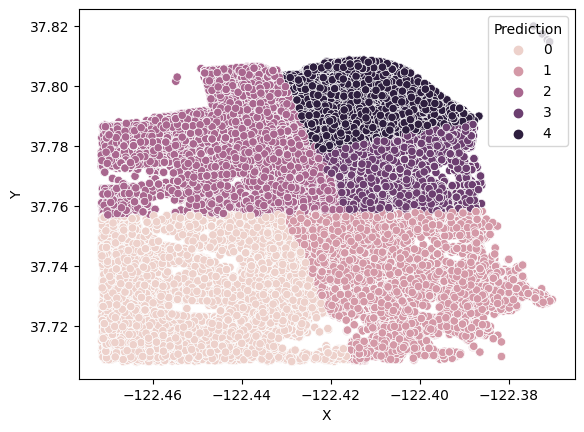

In [0]:
sns.scatterplot(data=transformed_pd, x="X", y="Y", hue="Prediction")
plt.show()

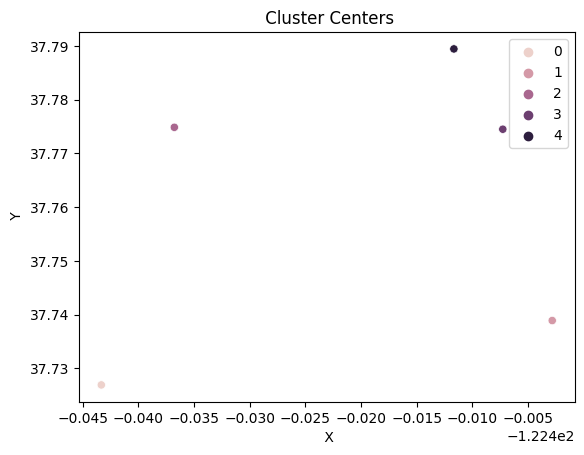

In [0]:
X_pos= [pos[0] for pos in model.clusterCenters()]
Y_pos= [pos[1] for pos in model.clusterCenters()]
ax= sns.scatterplot(x=X_pos,y=Y_pos, hue=[0,1,2,3,4] )
ax.set_xlabel(" X")
ax.set_ylabel(" Y")
ax.set_title(" Cluster Centers")
plt.show()

In [0]:
display(transformed.select(["Y","X"]))

Y,X
37.7083109744362,-122.420084075249
37.7243766140428,-122.43622001281
37.7709130566165,-122.410541166987
37.74515794927,-122.470365997562
37.775420706711,-122.40340479147905
37.70796836450968,-122.46354501681947
37.7082001648459,-122.459172646607
37.7304741509374,-122.389849114797
37.7969028838908,-122.406831986427
37.7848656939297,-122.412784096509


In [0]:
#Q9 Time Series Analysis

In [0]:
import urllib.request
#covid19 data
urllib.request.urlretrieve("https://data.sfgov.org/resource/d2ef-idww.csv", "/tmp/mycvoid.csv")
dbutils.fs.mv("file:/tmp/mycvoid.csv", "dbfs:/lingyiwu4/spark_hw1/data/covid19.csv")
#sf crime data 2018~present
urllib.request.urlretrieve("https://data.sfgov.org/resource/wg3w-h783.csv", "/tmp/mycrime.csv")
dbutils.fs.mv("file:/tmp/mycrime.csv", "dbfs:/lingyiwu4/spark_hw1/data/sf_2018_present.csv")
display(dbutils.fs.ls("dbfs:/lingyiwu4/spark_hw1/data/"))
crime_data_path = "dbfs:/lingyiwu4/spark_hw1/data/sf_2018_present.csv"
covid_data_path = "dbfs:/lingyiwu4/spark_hw1/data/covid19.csv"

path,name,size,modificationTime
dbfs:/lingyiwu4/spark_hw1/data/covid19.csv,covid19.csv,165748,1713763632000
dbfs:/lingyiwu4/spark_hw1/data/sf_04_21.csv,sf_04_21.csv,550945238,1713761848000
dbfs:/lingyiwu4/spark_hw1/data/sf_2018_present.csv,sf_2018_present.csv,308412,1713763633000


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import to_date, to_timestamp, hour
from pyspark.sql.functions import year, month, dayofmonth, date_format
from pyspark.sql.functions import from_unixtime, unix_timestamp
spark = SparkSession \
    .builder \
    .appName("crime analysis") \
    .config("spark.some.config.option", "some-value") \
    .getOrCreate()

df_covid = spark.read.option("header", "true").csv(covid_data_path)
display(df_covid)

specimen_collection_date,area_type,id,acs_population,new_confirmed_cases,cumulative_confirmed_cases,rate_of_cumulative_confirmed_cases,data_as_of,data_loaded_at
2020-11-15T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,4,1679,436.3305613305613,2023-09-11T04:30:00.820,2023-10-24T15:27:53.921
2023-05-29T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,1,14783,3841.735966735967,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226
2023-05-30T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,1,14784,3841.995841995842,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226
2023-05-31T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,3,14787,3842.775467775468,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226
2022-12-17T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,7,14078,3658.5239085239086,2023-09-11T04:30:00.820,2023-10-24T15:27:55.299
2022-12-16T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,11,14071,3656.7047817047815,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298
2022-12-15T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,12,14060,3653.846153846154,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298
2022-12-14T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,13,14048,3650.727650727651,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298
2022-12-13T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,21,14035,3647.3492723492723,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298
2022-12-12T00:00:00.000,Analysis Neighborhood,Bayview Hunters Point,38480,21,14014,3641.891891891892,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298


In [0]:
from pyspark.sql.functions import col, udf
from pyspark.sql.functions import expr
from pyspark.sql.functions import from_unixtime 
import datetime
date_func =  udf (lambda x: datetime.datetime.strptime(x, '%Y-%m-%dT%H:%M:%S.%f'), DateType())
 
df_covid = df_covid.withColumn('collect_Date', date_func(col('specimen_collection_date'))).drop(df_covid["specimen_collection_date"])
df_covid = df_covid.withColumn("Year", year(df_covid["collect_Date"]))
df_covid = df_covid.withColumn("Month", month(df_covid["collect_Date"]))
df_covid = df_covid.withColumn("cumulative_confirmed_cases", df_covid["cumulative_confirmed_cases"].cast("float"))  
df_covid = df_covid.withColumn("new_confirmed_cases", df_covid["new_confirmed_cases"].cast("float"))  
df_covid = df_covid.withColumn("acs_population", df_covid["acs_population"].cast("int"))  
display(df_covid)

area_type,id,acs_population,new_confirmed_cases,cumulative_confirmed_cases,rate_of_cumulative_confirmed_cases,data_as_of,data_loaded_at,collect_Date,Year,Month
Analysis Neighborhood,Bayview Hunters Point,38480,4.0,1679.0,436.3305613305613,2023-09-11T04:30:00.820,2023-10-24T15:27:53.921,2020-11-15,2020,11
Analysis Neighborhood,Bayview Hunters Point,38480,1.0,14783.0,3841.735966735967,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226,2023-05-29,2023,5
Analysis Neighborhood,Bayview Hunters Point,38480,1.0,14784.0,3841.995841995842,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226,2023-05-30,2023,5
Analysis Neighborhood,Bayview Hunters Point,38480,3.0,14787.0,3842.775467775468,2023-09-11T04:30:00.820,2023-10-24T15:28:03.226,2023-05-31,2023,5
Analysis Neighborhood,Bayview Hunters Point,38480,7.0,14078.0,3658.5239085239086,2023-09-11T04:30:00.820,2023-10-24T15:27:55.299,2022-12-17,2022,12
Analysis Neighborhood,Bayview Hunters Point,38480,11.0,14071.0,3656.7047817047815,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298,2022-12-16,2022,12
Analysis Neighborhood,Bayview Hunters Point,38480,12.0,14060.0,3653.846153846154,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298,2022-12-15,2022,12
Analysis Neighborhood,Bayview Hunters Point,38480,13.0,14048.0,3650.727650727651,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298,2022-12-14,2022,12
Analysis Neighborhood,Bayview Hunters Point,38480,21.0,14035.0,3647.3492723492723,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298,2022-12-13,2022,12
Analysis Neighborhood,Bayview Hunters Point,38480,21.0,14014.0,3641.891891891892,2023-09-11T04:30:00.820,2023-10-24T15:27:55.298,2022-12-12,2022,12


In [0]:
df_new_confirmed = df_covid.select(['new_confirmed_cases',"collect_Date"])
display(df_new_confirmed)

new_confirmed_cases,collect_Date
4.0,2020-11-15
1.0,2023-05-29
1.0,2023-05-30
3.0,2023-05-31
7.0,2022-12-17
11.0,2022-12-16
12.0,2022-12-15
13.0,2022-12-14
21.0,2022-12-13
21.0,2022-12-12


In [0]:
df_cumul_confirmed = df_covid.select(['cumulative_confirmed_cases',"collect_Date"])
display(df_cumul_confirmed)

cumulative_confirmed_cases,collect_Date
1679.0,2020-11-15
14783.0,2023-05-29
14784.0,2023-05-30
14787.0,2023-05-31
14078.0,2022-12-17
14071.0,2022-12-16
14060.0,2022-12-15
14048.0,2022-12-14
14035.0,2022-12-13
14014.0,2022-12-12


In [0]:
df_new_confirmed_pd=df_new_confirmed.toPandas()
df_new_confirmed_pd["moving_average"] = df_new_confirmed_pd["new_confirmed_cases"].rolling(window=10).mean()
display(df_new_confirmed_pd)

new_confirmed_cases,collect_Date,moving_average
4.0,2020-11-15,null
1.0,2023-05-29,null
1.0,2023-05-30,null
3.0,2023-05-31,null
7.0,2022-12-17,null
11.0,2022-12-16,null
12.0,2022-12-15,null
13.0,2022-12-14,null
21.0,2022-12-13,null
21.0,2022-12-12,9.4


In [0]:
from pyspark.sql import functions as F

date_func2 =  udf (lambda x: datetime.datetime.strptime(x, '%Y-%m-%dT%H:%M:%S.%f'), DateType())
df_sf_crime =spark.read.option("header", "true").csv("dbfs:/laioffer/spark_hw1/data/sf_2018_present.csv")
 
display(df_sf_crime)

incident_datetime,incident_date,incident_time,incident_year,incident_day_of_week,report_datetime,row_id,incident_id,incident_number,cad_number,report_type_code,report_type_description,filed_online,incident_code,incident_category,incident_subcategory,incident_description,resolution,intersection,cnn,police_district,analysis_neighborhood,supervisor_district,supervisor_district_2012,latitude,longitude,point,:@computed_region_jwn9_ihcz,:@computed_region_jg9y_a9du,:@computed_region_h4ep_8xdi,:@computed_region_n4xg_c4py,:@computed_region_nqbw_i6c3,:@computed_region_viu7_rrfi,:@computed_region_26cr_cadq,:@computed_region_qgnn_b9vv
2023-03-13T23:41:00.000,2023-03-13T00:00:00.000,23:41,2023,Monday,2023-03-13T23:41:00.000,125373607041,1253736,230167874,null,VS,Vehicle Supplement,null,07041,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,null,null,Out of SF,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-01T05:02:00.000,2023-03-01T00:00:00.000,05:02,2023,Wednesday,2023-03-11T15:40:00.000,125379506374,1253795,236046151,null,II,Coplogic Initial,true,06374,Larceny Theft,Larceny Theft - Other,"Theft, Other Property, >$950",Open or Active,null,null,Mission,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-13T13:16:00.000,2023-03-13T00:00:00.000,13:16,2023,Monday,2023-03-13T13:17:00.000,125357107041,1253571,220343896,null,VS,Vehicle Supplement,null,07041,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,null,null,Out of SF,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-13T10:59:00.000,2023-03-13T00:00:00.000,10:59,2023,Monday,2023-03-13T11:00:00.000,125355107041,1253551,230174885,null,VS,Vehicle Supplement,null,07041,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,null,null,Out of SF,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-14T18:44:00.000,2023-03-14T00:00:00.000,18:44,2023,Tuesday,2023-03-14T18:45:00.000,125402407041,1254024,230176728,null,VS,Vehicle Supplement,null,07041,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,null,null,Out of SF,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-02-15T03:00:00.000,2023-02-15T00:00:00.000,03:00,2023,Wednesday,2023-03-11T16:55:00.000,125378606372,1253786,236046123,null,II,Coplogic Initial,true,06372,Larceny Theft,Larceny Theft - Other,"Theft, Other Property, $50-$200",Open or Active,null,null,Mission,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-11T12:30:00.000,2023-03-11T00:00:00.000,12:30,2023,Saturday,2023-03-12T16:15:00.000,125381606244,1253816,236046004,null,II,Coplogic Initial,true,06244,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,null,null,Central,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-13T11:26:00.000,2023-03-13T00:00:00.000,11:26,2023,Monday,2023-03-13T13:37:00.000,125419506244,1254195,236046850,null,II,Coplogic Initial,true,06244,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,null,null,Central,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-11T15:00:00.000,2023-03-11T00:00:00.000,15:00,2023,Saturday,2023-03-13T08:29:00.000,125420606244,1254206,236045937,null,IS,Coplogic Supplement,true,06244,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,null,null,Central,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2023-03-11T14:00:00.000,2023-03-11T00:00:00.000,14:00,2023,Saturday,2023-03-15T11:21:00.000,125431804134,1254318,230182844,230741133,II,Initial,null,04134,Assault,Simple Assault,Battery,Open or Active,STANYAN ST \ HAYES ST,26446000,Park,Golden Gate Park,1,1,37.772895177200766,-122.45428511766733,POINT (-122.45428511766733 37.772895177200766),null,null,null,null,null,null,4,7


In [0]:
# data cleaning 
#Using regular expression to find valid string date and then remove invalid rows
df_sf_crime = df_sf_crime.withColumn("Date_Str", F.regexp_extract(df_sf_crime["incident_datetime"], r"[0-9]+(-)[0-9]+(-)[0-9]+(T)[0-9]+(:)[0-9]+(:)[0-9]+(.)[0-9]+",0))
df_sf_crime = df_sf_crime.where("Date_Str !='null' and Date_Str!=''")
df_sf_crime = df_sf_crime.withColumn("incident_date", date_func2(col('Date_Str')))
# convert data type to correct data type
df_sf_crime = df_sf_crime.withColumn("incident_Hour", hour(col("incident_time")))
 
df_sf_crime = df_sf_crime.withColumn("incident_year", col("incident_year").cast("int"))
df_sf_crime = df_sf_crime.withColumn("latitude", col("latitude").cast("double"))
df_sf_crime = df_sf_crime.withColumn("longitude", col("longitude").cast("double"))
df_sf_crime = df_sf_crime.withColumn("report_date", date_func2(col("report_datetime")))
df_sf_crime = df_sf_crime.select(["incident_Hour","incident_year",\
                             "incident_date","incident_time","incident_day_of_week",\
                                "incident_number","incident_category","incident_subcategory","incident_description",\
                                  "resolution","report_date","intersection","police_district","latitude","longitude"])
display(df_sf_crime)

incident_Hour,incident_year,incident_date,incident_time,incident_day_of_week,incident_number,incident_category,incident_subcategory,incident_description,resolution,report_date,intersection,police_district,latitude,longitude
23,2023,2023-03-13,23:41,Monday,230167874,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,2023-03-13,null,Out of SF,null,null
5,2023,2023-03-01,05:02,Wednesday,236046151,Larceny Theft,Larceny Theft - Other,"Theft, Other Property, >$950",Open or Active,2023-03-11,null,Mission,null,null
13,2023,2023-03-13,13:16,Monday,220343896,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,2023-03-13,null,Out of SF,null,null
10,2023,2023-03-13,10:59,Monday,230174885,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,2023-03-13,null,Out of SF,null,null
18,2023,2023-03-14,18:44,Tuesday,230176728,Recovered Vehicle,Recovered Vehicle,"Vehicle, Recovered, Auto",Open or Active,2023-03-14,null,Out of SF,null,null
3,2023,2023-02-15,03:00,Wednesday,236046123,Larceny Theft,Larceny Theft - Other,"Theft, Other Property, $50-$200",Open or Active,2023-03-11,null,Mission,null,null
12,2023,2023-03-11,12:30,Saturday,236046004,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,2023-03-12,null,Central,null,null
11,2023,2023-03-13,11:26,Monday,236046850,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,2023-03-13,null,Central,null,null
15,2023,2023-03-11,15:00,Saturday,236045937,Larceny Theft,Larceny - From Vehicle,"Theft, From Locked Vehicle, >$950",Open or Active,2023-03-13,null,Central,null,null
14,2023,2023-03-11,14:00,Saturday,230182844,Assault,Simple Assault,Battery,Open or Active,2023-03-15,STANYAN ST \ HAYES ST,Park,37.772895177200766,-122.45428511766733


In [0]:
df_sf_crime.createOrReplaceTempView("present_sf_crime")
df_crime_count =spark.sql(" with sf_crime_count as (select incident_date , incident_category from present_sf_crime where incident_category not in ('Non-Criminal'))\
                          select incident_date, count(incident_date) as crime_count \
                          from sf_crime_count \
                          group by incident_date \
                          order by incident_date asc")
display(df_crime_count)

incident_date,crime_count
2018-01-01,1
2018-01-09,1
2018-01-11,1
2018-01-13,3
2018-01-18,1
2018-01-19,1
2018-01-31,1
2018-02-04,1
2018-02-12,1
2018-02-16,2


In [0]:
df_crime_count_2020 =spark.sql(" with sf_crime_count as (select incident_date , incident_category from present_sf_crime where incident_category not in ('Non-Criminal'))\
                          select incident_date, count(incident_date) as crime_count \
                          from sf_crime_count \
                          group by incident_date having year(incident_date) =2020\
                          order by incident_date asc")
display(df_crime_count_2020)

---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-2128450962218664>, line 1
----> 1 df_crime_count_2020 =spark.sql(" with sf_crime_count as (select incident_date , incident_category from present_sf_crime where incident_category not in ('Non-Criminal'))\
      2                           select incident_date, count(incident_date) as crime_count \
      3                           from sf_crime_count \
      4                           group by incident_date having year(incident_date) =2020\
      5                           order by incident_date asc")
      6 display(df_crime_count_2020)

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, functio

In [0]:
df_crime_count_2020_pd =df_crime_count.toPandas()

In [0]:
cat_crime = spark.sql("with crime_count as (select incident_date , incident_category from present_sf_crime where incident_category not in ('Non-Criminal')) \
          select incident_date , incident_category, count(incident_category) as cat_crime_count\
          from crime_count\
          group by incident_date , incident_category order by  incident_date")
display(cat_crime)

incident_date,incident_category,cat_crime_count
2018-01-01,Larceny Theft,1
2018-01-09,Warrant,1
2018-01-11,Lost Property,1
2018-01-13,Larceny Theft,1
2018-01-13,Lost Property,1
2018-01-13,Recovered Vehicle,1
2018-01-18,Lost Property,1
2018-01-19,Lost Property,1
2018-01-31,Larceny Theft,1
2018-02-04,Lost Property,1
